In [ ]:
!pip install pmdarima

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.2/2.2 MB 21.1 MB/s eta 0:00:00



# Utils

In [ ]:
def seasonal_decompose_plot(column_name):
    # Ensure the index is a DatetimeIndex
    if not isinstance(df.index, pd.DatetimeIndex):
        df.index = pd.to_datetime(df.index)

    # Perform seasonal decomposition
    result = seasonal_decompose(df[column_name], model='additive', extrapolate_trend='freq',)

    # Get the individual components
    trend = result.trend
    seasonal = result.seasonal
    residual = result.resid

    # Create a large figure to accommodate subplots
    fig, axes = plt.subplots(ncols=1, nrows=4, figsize=(12, 10), sharex=True)  # Adjust figsize as needed

    # Plotting each component on its respective subplot
    axes[0].plot(df.index, trend, label='Trend', color='blue')
    axes[0].legend(loc='upper right')
    axes[0].set_title('Trend')

    axes[1].plot(df.index, seasonal, label='Seasonality', color='green')
    axes[1].legend(loc='upper right')
    axes[1].set_title('Seasonality')

    axes[2].plot(df.index, residual, label='Residuals', color='red')
    axes[2].legend(loc='upper right')
    axes[2].set_title('Residuals')

    axes[3].plot(df.index, df[column_name], label='Original', color='purple')
    axes[3].legend(loc='upper right')
    axes[3].set_title('Original Series')

    # Format x-axis to display dates properly
    for ax in axes:
        ax.xaxis.set_major_formatter(mdates.DateFormatter('%Y-%m-%d'))
        ax.xaxis.set_major_locator(mdates.AutoDateLocator())
        ax.tick_params(axis='x', rotation=45)  # Rotate x-axis labels for better readability

    # Enhancing the overall layout
    plt.tight_layout()
    fig.subplots_adjust(top=0.9)  # Adjust to fit the suptitle
    plt.suptitle(f'Seasonal Decomposition of {column_name}', fontsize=16)
    plt.show()

    return result

In [ ]:
def plot_monthly_graph(column_name,unit):
  # Recalculating the min and max values and their corresponding indices
  min_value = df[column_name].min()
  max_value = df[column_name].max()
  min_date = df[df[column_name] == min_value].index[0]
  max_date = df[df[column_name] == max_value].index[0]

  # Create the plot again with the corrected date indexing
  fig, ax = plt.subplots(figsize=(50, 10))
  fig.suptitle(f'Monthly Time Series Analysis of {column_name} with Min/Max Highlighted')

  # Plotting the data
  ax.plot(df.index, df[column_name], linestyle='-', label=column_name)
  ax.set_xlabel('Month')
  ax.set_ylabel(unit)

  # Highlighting the min and max points
  ax.scatter(min_date, min_value, color='red', s=100, label='Min Value', zorder=5)
  ax.scatter(max_date, max_value, color='green', s=100, label='Max Value', zorder=5)

  # Annotating the min and max points
  ax.annotate(f'Min: {min_value} ', (min_date, min_value), textcoords="offset points", xytext=(-15,-15), ha='center', color='red')
  ax.annotate(f'Max: {max_value} ', (max_date, max_value), textcoords="offset points", xytext=(15,15), ha='center', color='green')

  # Setting x-axis to display month and year
  ax.xaxis.set_major_locator(mdates.MonthLocator())
  ax.xaxis.set_major_formatter(mdates.DateFormatter('%Y-%m'))

  # Improve formatting and add a legend
  fig.autofmt_xdate()  # Auto rotates dates for better readability
  ax.legend()

  plt.show()


In [ ]:
import pandas as pd
import matplotlib.pyplot as plt

def plot_yearly_stats_separate(df, column_name):
    # Check if the column exists in the DataFrame
    if column_name not in df.columns:
        print("Error: Column name not found in DataFrame.")
        return

    # Determine the start and end dates from the DataFrame's index
    start_date = df.index.min()
    end_date = df.index.max()

    # Ensure the DataFrame is within the desired date range
    df = df[(df.index >= start_date) & (df.index <= end_date)]

    # Calculate means and variances for each year
    yearly_stats = {
        year: {
            'mean': df[df.index.year == year][column_name].mean(),
            'variance': df[df.index.year == year][column_name].var()
        }
        for year in range(start_date.year, end_date.year + 1)
    }

    # Extracting data for plotting
    years = list(yearly_stats.keys())
    means = [stats['mean'] for stats in yearly_stats.values()]
    variances = [stats['variance'] for stats in yearly_stats.values()]

    # Create a figure and a set of subplots
    fig, (ax1, ax2) = plt.subplots(nrows=2, ncols=1, figsize=(10, 10))

    # Plot the means on the first subplot
    ax1.plot(years, means, marker='o', linestyle='-', color='tab:red')
    ax1.set_title(f'Annual Means of {column_name}')
    ax1.set_xlabel('Year')
    ax1.set_ylabel('Mean')
    ax1.grid(True)

    # Plot the variances on the second subplot
    ax2.plot(years, variances, marker='o', linestyle='-', color='tab:blue')
    ax2.set_title(f'Annual Variances of {column_name}')
    ax2.set_xlabel('Year')
    ax2.set_ylabel('Variance')
    ax2.grid(True)

    # Adjust layout to prevent overlap
    fig.tight_layout()
    plt.show()

# Example usage with a DataFrame 'df' and a column 'Heat - RFG_sqrt'
# plot_yearly_stats_separate(df, 'Heat - RFG_sqrt')


In [ ]:
def plot_dynamic_histogram(df, column_name, figsize=(10, 5), bin_width=10):
    # Check if the column exists in the DataFrame
    if column_name not in df.columns:
        print("Error: Column name not found in DataFrame.")
        return

    # Determine the minimum and maximum values in the column
    min_val = int(df[column_name].min())
    max_val = int(df[column_name].max())

    # Create bins with a larger interval defined by bin_width
    if min_val % bin_width != 0:
        min_val = (min_val // bin_width) * bin_width
    if max_val % bin_width != 0:
        max_val = ((max_val // bin_width) + 1) * bin_width

    bins = [x for x in range(min_val, max_val + bin_width, bin_width)]

    # Plotting the histogram with dynamic bins and custom figure size
    df[column_name].hist(bins=bins, figsize=figsize, rwidth=0.8, alpha=0.75)

    # Setting x-axis ticks to align with bins
    plt.xticks(ticks=bins)

    # Rotate x-axis ticks if necessary
    plt.xticks(rotation=45)  # Rotate labels to 45 degrees to avoid overlap

    plt.xlabel(f'{column_name} Values')
    plt.ylabel('Frequency')
    plt.title(f'Histogram of {column_name}')
    plt.grid(True)
    plt.show()

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt

def plot_individual_value_histogram(df, column_name, figsize=(10, 5)):
    # Check if the column exists in the DataFrame
    if column_name not in df.columns:
        print("Error: Column name not found in DataFrame.")
        return

    # Determine the minimum and maximum values in the column
    min_val = int(df[column_name].min())
    max_val = int(df[column_name].max())

    # Create bins such that each integer has its own bin
    bins = [x - 0.5 for x in range(min_val, max_val + 2)]  # +2 to ensure the last value is included as its own bin

    # Plotting the histogram with bins separating each integer
    df[column_name].hist(bins=bins, figsize=figsize, rwidth=0.8, alpha=0.75)

    # Setting x-axis ticks to be centered for each integer value
    plt.xticks(ticks=range(min_val, max_val + 1))
    plt.xticks(rotation=45)

    plt.xlabel(f'{column_name} Values')
    plt.ylabel('Frequency')
    plt.title(f'Histogram of {column_name}')
    plt.grid(True)
    plt.show()

# Example usage:
# Assuming 'df' is your DataFrame and 'Heat - RFG' is the column of interest
# plot_individual_value_histogram(df, 'Heat - RFG', figsize=(12, 6))


# Start

In [ ]:
import warnings
warnings.filterwarnings('ignore')

In [ ]:
import pandas as pd
import statistics
import numpy as np
import matplotlib.pyplot as plt
from scipy.stats import norm
import seaborn as sns
from statsmodels.tsa.seasonal import seasonal_decompose
import matplotlib.dates as mdates
from sklearn.preprocessing import StandardScaler, MaxAbsScaler,MinMaxScaler
from statsmodels.tsa.seasonal import seasonal_decompose
from statsmodels.tsa.stattools import adfuller
import matplotlib.pyplot as plt
from statsmodels.graphics.tsaplots import plot_pacf, plot_acf
from statsmodels.tsa.arima_model import ARIMA
import pmdarima as pm
from statsmodels.tsa.arima.model import ARIMA
from scipy.special import inv_boxcox
from sklearn.metrics import mean_squared_error, mean_absolute_error
from prophet import Prophet

In [ ]:
df=pd.read_excel('/content/drive/MyDrive/Oil and Gas Project(Data Science)/Data/DataRecivedOnJan15/BoilerDailyData/BoilerDailyData/5YearsOfDailyData.xlsx')

In [ ]:
df.columns

Index(['Time', 'Heat - RFG', 'Heat - RFG DQ', 'Temp -1', 'Temp -1DQ',
       'Temp - 2', 'Temp - 2DQ', 'Temp - 3', 'Temp - 3DQ', 'OP2 Tail Gas LHV',
       'OP2 Tail Gas LHVDQ', 'OP2 Tail Gas MW', 'OP2 Tail Gas MWDQ',
       'Flow - OP2 Tail Gas', 'Flow - OP2 Tail GasDQ',
       'Firing Rate of HRVOC Fuels to BIF (EBT and OP2 Tail Gas), HHV',
       'Firing Rate of HRVOC Fuels to BIF (EBT and OP2 Tail Gas), HHVDQ',
       'Total Firing Rate of BIF (NG + EBT + OP2 Tail Gas + Phen HE), HHV',
       'Total Firing Rate of BIF (NG + EBT + OP2 Tail Gas + Phen HE), HHVDQ',
       'Heat - TG', 'Heat - TGDQ', 'HRVOC Steam Production',
       'HRVOC Steam ProductionDQ', 'Flow - RFG', 'Flow - RFGDQ'],
      dtype='object')

In [ ]:
df.index=df['Time']

In [ ]:
df.columns

Index(['Time', 'Heat - RFG', 'Heat - RFG DQ', 'Temp -1', 'Temp -1DQ',
       'Temp - 2', 'Temp - 2DQ', 'Temp - 3', 'Temp - 3DQ', 'OP2 Tail Gas LHV',
       'OP2 Tail Gas LHVDQ', 'OP2 Tail Gas MW', 'OP2 Tail Gas MWDQ',
       'Flow - OP2 Tail Gas', 'Flow - OP2 Tail GasDQ',
       'Firing Rate of HRVOC Fuels to BIF (EBT and OP2 Tail Gas), HHV',
       'Firing Rate of HRVOC Fuels to BIF (EBT and OP2 Tail Gas), HHVDQ',
       'Total Firing Rate of BIF (NG + EBT + OP2 Tail Gas + Phen HE), HHV',
       'Total Firing Rate of BIF (NG + EBT + OP2 Tail Gas + Phen HE), HHVDQ',
       'Heat - TG', 'Heat - TGDQ', 'HRVOC Steam Production',
       'HRVOC Steam ProductionDQ', 'Flow - RFG', 'Flow - RFGDQ'],
      dtype='object')

In [ ]:
df.drop(columns=['Time'],axis=True,inplace=True)

In [ ]:
df.head(20)

,Heat - RFG,Heat - RFG DQ,Temp -1,Temp -1DQ,Temp - 2,Temp - 2DQ,Temp - 3,Temp - 3DQ,OP2 Tail Gas LHV,OP2 Tail Gas LHVDQ,...,"Firing Rate of HRVOC Fuels to BIF (EBT and OP2 Tail Gas), HHV","Firing Rate of HRVOC Fuels to BIF (EBT and OP2 Tail Gas), HHVDQ","Total Firing Rate of BIF (NG + EBT + OP2 Tail Gas + Phen HE), HHV","Total Firing Rate of BIF (NG + EBT + OP2 Tail Gas + Phen HE), HHVDQ",Heat - TG,Heat - TGDQ,HRVOC Steam Production,HRVOC Steam ProductionDQ,Flow - RFG,Flow - RFGDQ
Time,,,,,,,,,,,,,,,,,,,,,
2020-01-14,1.303282,100.0,11.323288,100.0,8.559771,100.0,1656.461339,100.0,436.000000,100.0,...,282.703490,100.0,282.915687,100.0,197.082233,100.0,222.419835,100,3.131766,100.0
2020-01-15,1.444607,100.0,8.132504,100.0,4.804577,100.0,1681.183686,100.0,440.827068,100.0,...,281.994893,100.0,282.176820,100.0,195.977245,100.0,227.112198,100,3.134533,100.0
2020-01-16,1.422489,100.0,5.858195,100.0,6.057803,100.0,1683.815123,100.0,445.000000,100.0,...,281.142456,100.0,281.315184,100.0,194.590340,100.0,220.828435,100,3.146040,100.0
2020-01-17,1.223333,100.0,4.227217,100.0,14.933586,100.0,1688.462749,100.0,445.000000,100.0,...,283.699685,100.0,283.885001,100.0,195.315875,100.0,222.585199,100,3.165772,100.0
2020-01-18,1.571879,100.0,15.755301,100.0,15.503144,100.0,1690.664280,100.0,445.000000,100.0,...,285.563361,100.0,285.770271,100.0,198.252741,100.0,225.633998,100,3.142206,100.0
2020-01-19,1.594717,100.0,8.231075,100.0,11.945745,100.0,1714.057072,100.0,445.000000,100.0,...,285.627111,100.0,285.849367,100.0,195.160086,100.0,226.209583,100,3.179088,100.0
2020-01-20,1.719666,100.0,7.897270,100.0,8.982067,100.0,1695.176325,100.0,445.000000,100.0,...,284.660480,100.0,284.902560,100.0,194.300110,100.0,228.365213,100,3.194651,100.0
2020-01-21,1.392033,100.0,6.579285,100.0,9.980911,100.0,1711.437934,100.0,445.000000,100.0,...,284.143929,100.0,284.394107,100.0,194.653462,100.0,226.789116,100,3.175778,100.0
2020-01-22,1.610334,100.0,6.541428,100.0,22.387551,100.0,1687.950490,100.0,441.620382,100.0,...,284.087668,100.0,284.330933,100.0,194.709929,100.0,223.774488,100,3.180455,100.0


# Checking Missing Dates

In [ ]:
full_range = pd.date_range(start=df.index.min(), end=df.index.max())

In [ ]:
missing_dates = full_range.difference(df.index)


In [ ]:
print("Missing dates in the dataset are:", missing_dates)

Missing dates in the dataset are: DatetimeIndex([], dtype='datetime64[ns]', freq='D')


No dates are missing lets check missing data in columns

# Check Missing Values

In [ ]:
# Function to check if the value exists in the column and is a string
def contains_special_value(column):
    if column.dtype == object:  # typically used for strings in pandas
        return column.str.contains("[-11059]", na=False)
    else:
        return pd.Series([False] * len(column), index=column.index)

# Apply the function to each column in the DataFrame
matches = df.apply(contains_special_value)

# Display results
print("Data containing '[-11059] No Good Data For Calculation':")
for col in matches.columns:
    if matches[col].any():
        print(f"Column '{col}' contains the special value at rows: {matches[matches[col]].index.tolist()}")


Data containing '[-11059] No Good Data For Calculation':
Column 'HRVOC Steam Production' contains the special value at rows: [Timestamp('2021-11-09 00:00:00'), Timestamp('2021-11-10 00:00:00'), Timestamp('2021-11-11 00:00:00'), Timestamp('2021-11-12 00:00:00'), Timestamp('2021-11-13 00:00:00'), Timestamp('2021-11-14 00:00:00'), Timestamp('2021-11-15 00:00:00'), Timestamp('2021-11-16 00:00:00'), Timestamp('2021-11-17 00:00:00'), Timestamp('2021-11-18 00:00:00')]
Column 'HRVOC Steam ProductionDQ' contains the special value at rows: [Timestamp('2021-11-09 00:00:00'), Timestamp('2021-11-10 00:00:00'), Timestamp('2021-11-11 00:00:00'), Timestamp('2021-11-12 00:00:00'), Timestamp('2021-11-13 00:00:00'), Timestamp('2021-11-14 00:00:00'), Timestamp('2021-11-15 00:00:00'), Timestamp('2021-11-16 00:00:00'), Timestamp('2021-11-17 00:00:00'), Timestamp('2021-11-18 00:00:00')]


In [ ]:
def replace_special_value(column):
    if column.dtype == object:  # typically used for strings in pandas
        return column.replace("[-11059] No Good Data For Calculation", np.nan)
    else:
        return column

df = df.apply(replace_special_value)

In [ ]:
 df.isna().sum()

,0
Heat - RFG,0
Heat - RFG DQ,0
Temp -1,0
Temp -1DQ,0
Temp - 2,0
Temp - 2DQ,0
Temp - 3,0
Temp - 3DQ,0
OP2 Tail Gas LHV,0
OP2 Tail Gas LHVDQ,0


Now fill the nan with surrounding values

# Impute the missing values

In [ ]:
df.fillna(method='ffill',inplace=True)

In [ ]:
df.isna().sum()

,0
Heat - RFG,0
Heat - RFG DQ,0
Temp -1,0
Temp -1DQ,0
Temp - 2,0
Temp - 2DQ,0
Temp - 3,0
Temp - 3DQ,0
OP2 Tail Gas LHV,0
OP2 Tail Gas LHVDQ,0


Now there is no missing values in the dataset

# Plot Whole dataset

In [ ]:
filtered_columns = [col for col in df.columns if not col.endswith('DQ')]

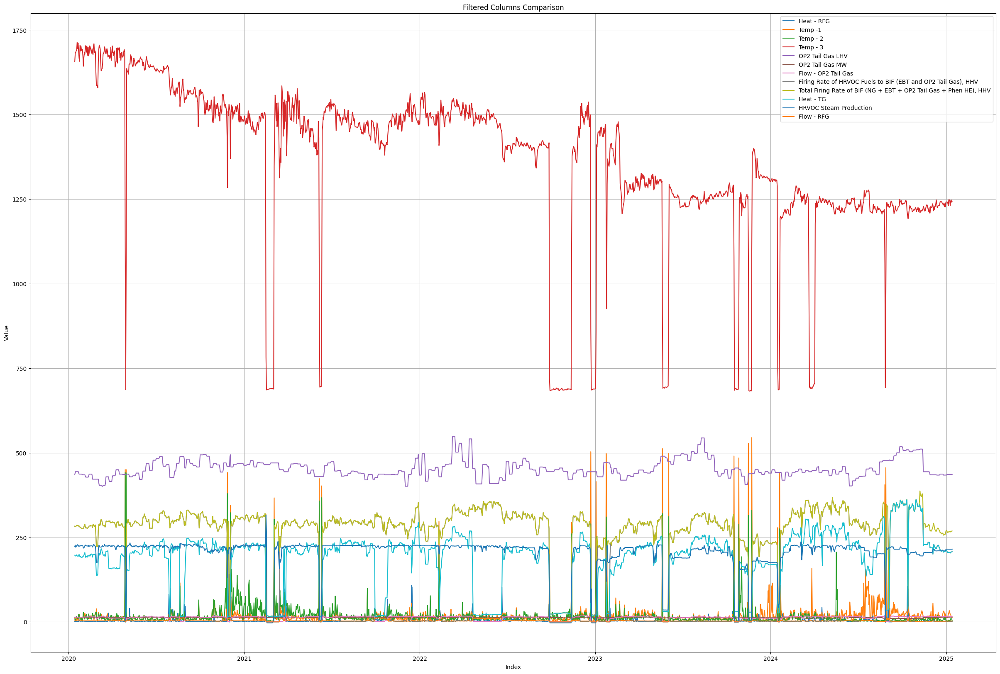

In [ ]:
plt.figure(figsize=(30, 20))
for column in filtered_columns:
    plt.plot(df.index, df[column], label=column)  # Plot each column with a label

plt.title('Filtered Columns Comparison')
plt.xlabel('Index')
plt.ylabel('Value')
plt.grid(True)
plt.legend()  # Display the legend to show which line corresponds to which column
plt.show()

As we can see, the graph is not ideal because the range of values across different columns varies significantly. Let's standardize the data for the sake of plotting this graph, so we can better understand the time series and compare the columns more effectively

# Standardize dataset

In [ ]:
scaler =MaxAbsScaler()

# Fit and transform the data
df_scaled = pd.DataFrame(scaler.fit_transform(df[filtered_columns]), columns=filtered_columns)

In [ ]:
# Plotting all filtered and scaled columns on one plot
plt.figure(figsize=(200, 50))
for column in filtered_columns:
    plt.plot(df.index, df_scaled[column], label=column)  # Plot each standardized column

plt.title('Standardized Columns Comparison')
plt.xlabel('Index')
plt.ylabel('Standardized Value')
plt.grid(True)
plt.legend()  # Display the legend to show which line corresponds to which column
plt.show()

# Plotting only Temprature columns

In [ ]:
filtered_columns

['Heat - RFG',
 'Temp -1',
 'Temp - 2',
 'Temp - 3',
 'OP2 Tail Gas LHV',
 'OP2 Tail Gas MW',
 'Flow - OP2 Tail Gas',
 'Firing Rate of HRVOC Fuels to BIF (EBT and OP2 Tail Gas), HHV',
 'Total Firing Rate of BIF (NG + EBT + OP2 Tail Gas + Phen HE), HHV',
 'Heat - TG',
 'HRVOC Steam Production',
 'Flow - RFG']

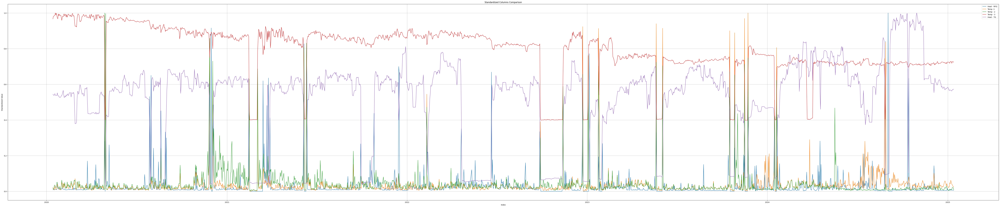

In [ ]:
# Plotting all filtered and scaled columns on one plot
plt.figure(figsize=(100, 20))
for column in['Heat - RFG','Temp -1','Temp - 2','Temp - 3',"Heat - TG"]:
    plt.plot(df.index, df_scaled[column], label=column)  # Plot each standardized column

plt.title('Standardized Columns Comparison')
plt.xlabel('Index')
plt.ylabel('Standardized Value')
plt.grid(True)
plt.legend()  # Display the legend to show which line corresponds to which column
plt.show()

# Plotting only GAS columns

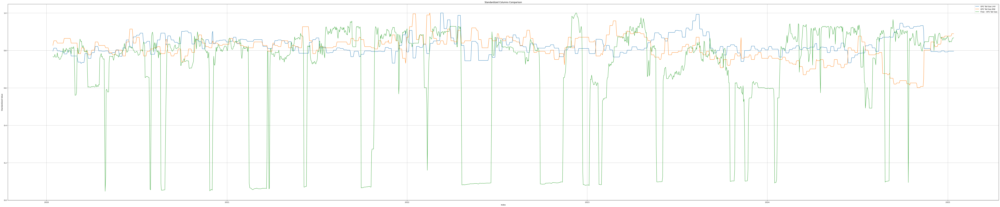

In [ ]:
# Plotting all filtered and scaled columns on one plot
plt.figure(figsize=(100, 20))
for column in[ 'OP2 Tail Gas LHV','OP2 Tail Gas MW','Flow - OP2 Tail Gas']:
    plt.plot(df.index, df_scaled[column], label=column)  # Plot each standardized column

plt.title('Standardized Columns Comparison')
plt.xlabel('Index')
plt.ylabel('Standardized Value')
plt.grid(True)
plt.legend()  # Display the legend to show which line corresponds to which column
plt.show()

# Plotting All Remaining Columns

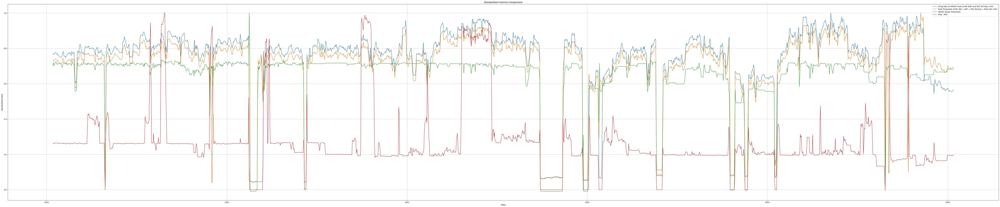

In [ ]:
# Plotting all filtered and scaled columns on one plot
plt.figure(figsize=(100, 20))
for column in ['Firing Rate of HRVOC Fuels to BIF (EBT and OP2 Tail Gas), HHV','Total Firing Rate of BIF (NG + EBT + OP2 Tail Gas + Phen HE), HHV','HRVOC Steam Production','Flow - RFG']:
    plt.plot(df.index, df_scaled[column], label=column)  # Plot each standardized column

plt.title('Standardized Columns Comparisone')
plt.xlabel('Index')
plt.ylabel('Standardized Value')
plt.grid(True)
plt.legend()  # Display the legend to show which line corresponds to which column
plt.show()

Upon reviewing the graphs, it appears that there is some seasonality present in the dataset. We will further analyze this by applying the seasonal decomposotion test to assess the seasonality of the dataset.

# EDA of all Columns one by one

In [ ]:
filtered_columns

['Heat - RFG',
 'Temp -1',
 'Temp - 2',
 'Temp - 3',
 'OP2 Tail Gas LHV',
 'OP2 Tail Gas MW',
 'Flow - OP2 Tail Gas',
 'Firing Rate of HRVOC Fuels to BIF (EBT and OP2 Tail Gas), HHV',
 'Total Firing Rate of BIF (NG + EBT + OP2 Tail Gas + Phen HE), HHV',
 'Heat - TG',
 'HRVOC Steam Production',
 'Flow - RFG']

## Heat - RFG

### Min Max Value

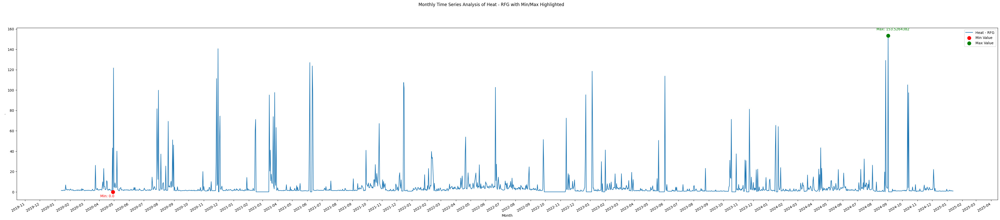

In [ ]:
plot_monthly_graph('Heat - RFG','.')

### Histogram

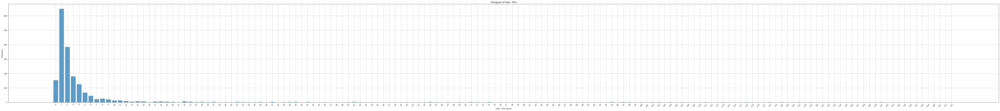

In [ ]:
plot_individual_value_histogram(df,'Heat - RFG',figsize=(100, 10))

### Mean and Variance Plot

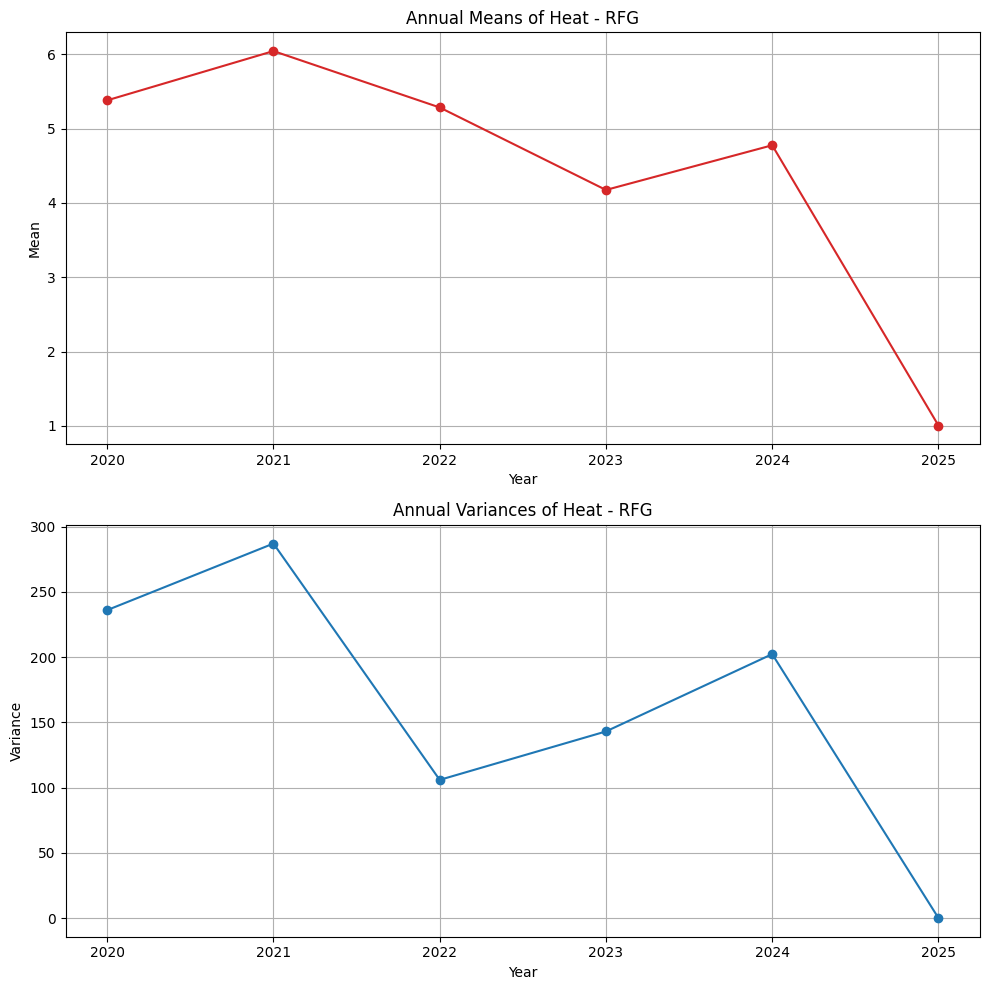

In [ ]:
plot_yearly_stats_separate(df, 'Heat - RFG')

### Augmented Dickey Fuller Test

In [ ]:
adf, pvalue, usedlag, nobs, critical_values, icbest = adfuller(df['Heat - RFG'])
print(f'ADF Statistic: {adf}')
print(f'p-value: {pvalue}')


ADF Statistic: -13.923007482760829
p-value: 5.253893599639498e-26


## Temp -1

### Min Max Value

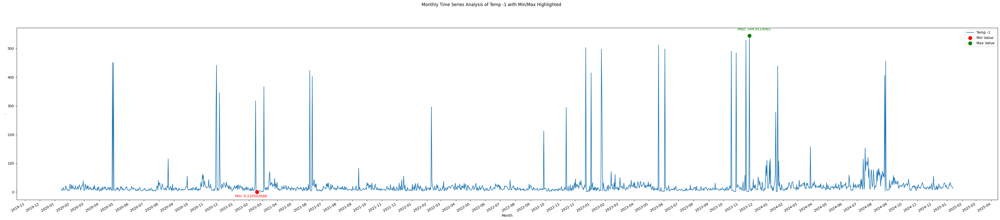

In [ ]:
plot_monthly_graph('Temp -1','.')

### Histogram

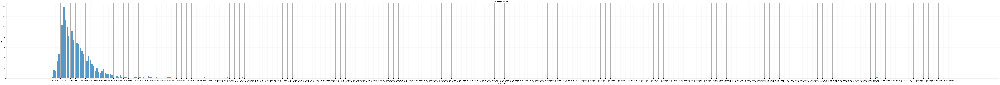

In [ ]:
plot_individual_value_histogram(df,'Temp -1',figsize=(130, 10))

### Mean and Variance Plot

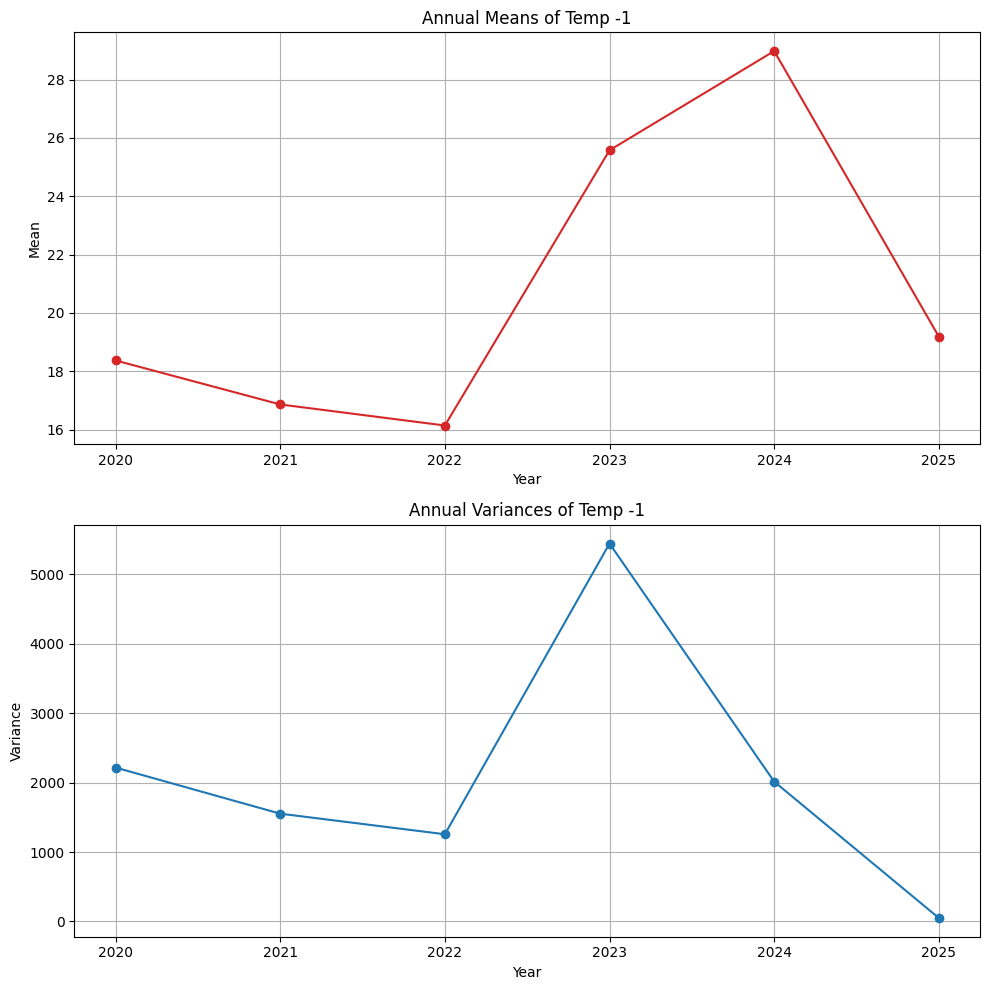

In [ ]:
plot_yearly_stats_separate(df, 'Temp -1')

### Augmented Dickey Fuller Test

In [ ]:
adf, pvalue, usedlag, nobs, critical_values, icbest = adfuller(df['Temp -1'])
print(f'ADF Statistic: {adf}')
print(f'p-value: {pvalue}')

ADF Statistic: -9.715434180854187
p-value: 9.85890633611802e-17


## Temp -2

### Min Max Value

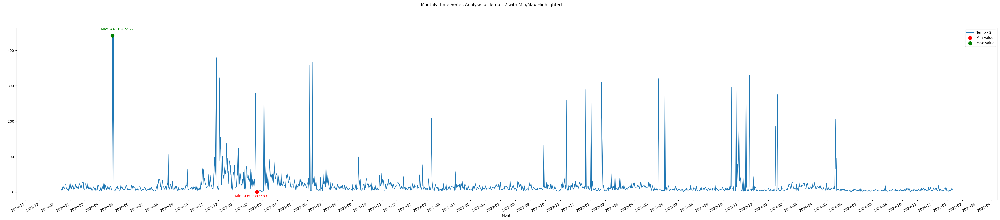

In [ ]:
plot_monthly_graph('Temp - 2','.')

### Histogram

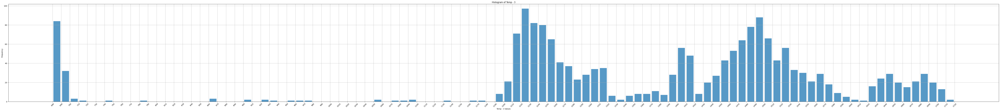

In [ ]:
plot_dynamic_histogram(df,'Temp - 3',figsize=(100, 10),bin_width=10)

### Mean and Variance Plot

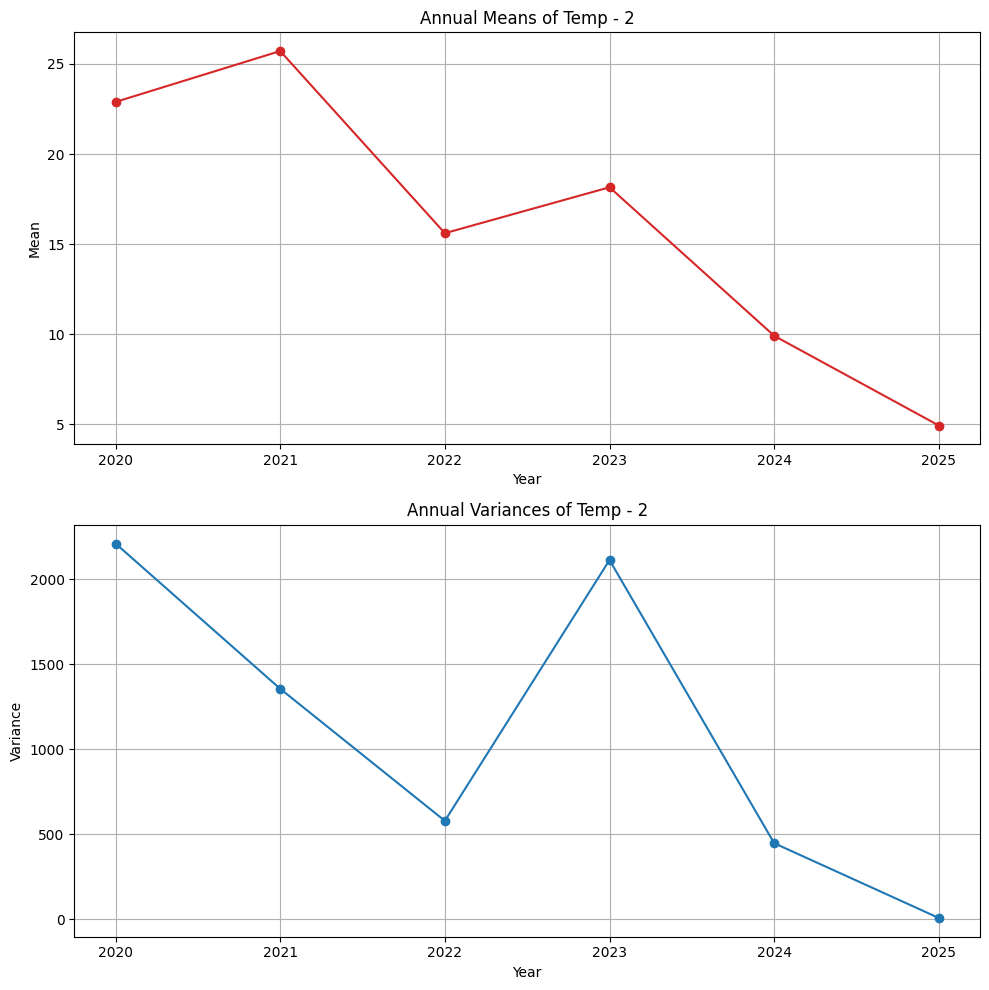

In [ ]:
plot_yearly_stats_separate(df, 'Temp - 2')

### Augmented Dickey Fuller Test


In [ ]:
adf, pvalue, usedlag, nobs, critical_values, icbest = adfuller(df['Temp - 2'])
print(f'ADF Statistic: {adf}')
print(f'p-value: {pvalue}')

ADF Statistic: -5.385617353550666
p-value: 3.6309493345246864e-06


## Temp - 3

### Min Max Value


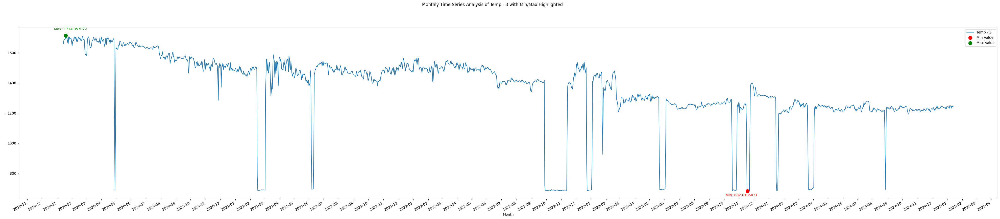

In [ ]:
plot_monthly_graph('Temp - 3','.')

### Histogram


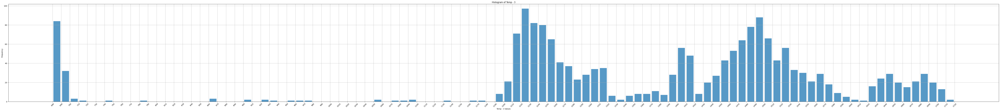

In [ ]:
plot_dynamic_histogram(df,'Temp - 3',figsize=(100, 10),bin_width=10)

### Mean and Variance Plot


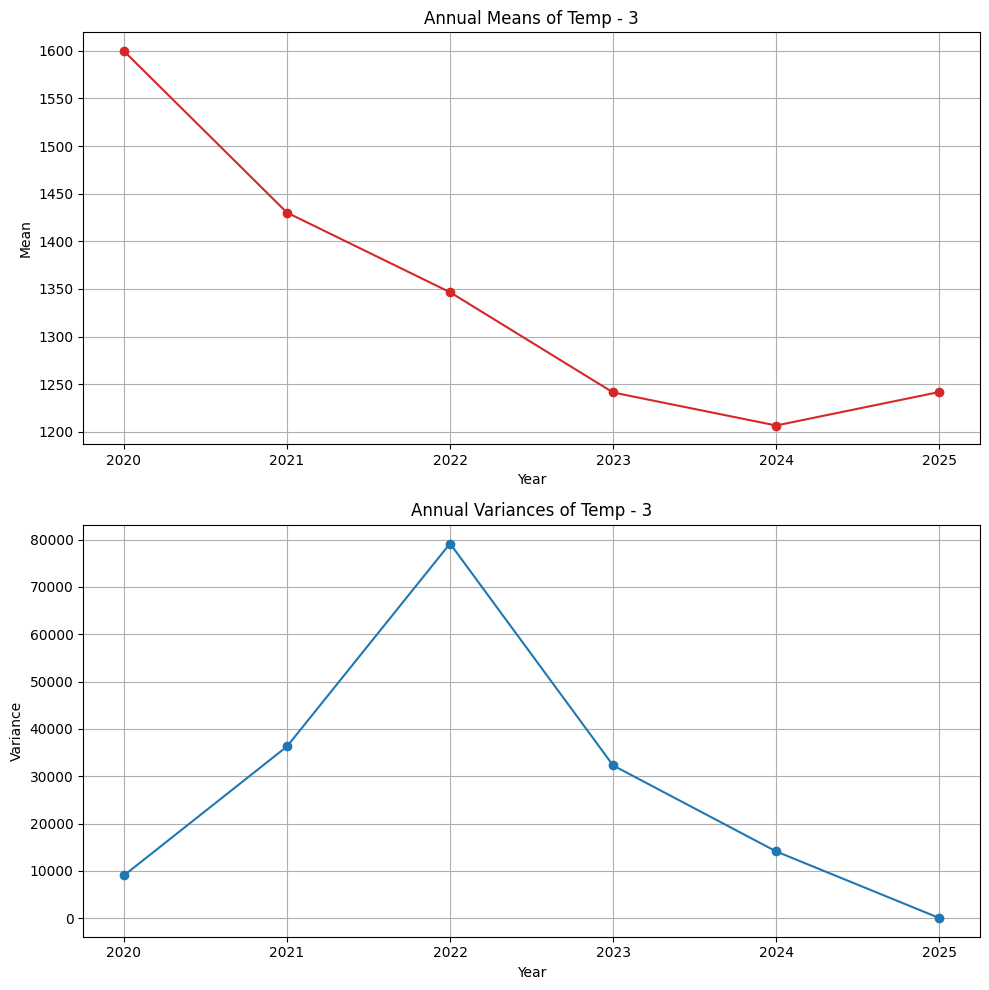

In [ ]:
plot_yearly_stats_separate(df, 'Temp - 3')

### Augmented Dickey Fuller Test


In [ ]:
adf, pvalue, usedlag, nobs, critical_values, icbest = adfuller(df['Temp - 3'])
print(f'ADF Statistic: {adf}')
print(f'p-value: {pvalue}')

ADF Statistic: -3.9907128968095407
p-value: 0.0014599296369504544


## OP2 Tail Gas LHV

### Min Max Value


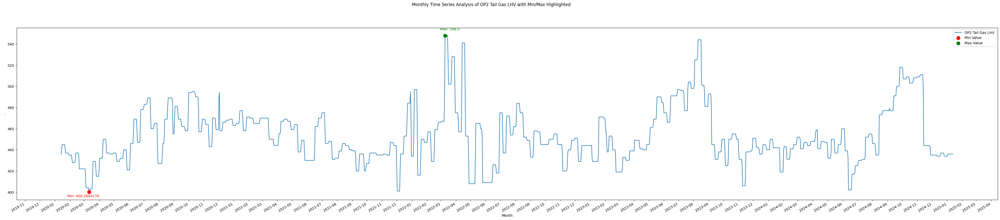

In [ ]:
plot_monthly_graph('OP2 Tail Gas LHV','.')

### Histogram

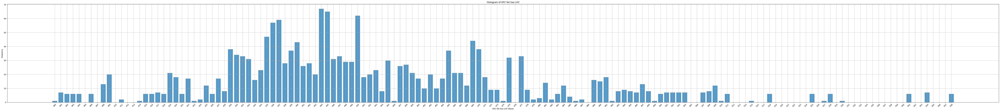

In [ ]:
plot_individual_value_histogram(df,'OP2 Tail Gas LHV',figsize=(100, 10))

### Mean and Variance Plot

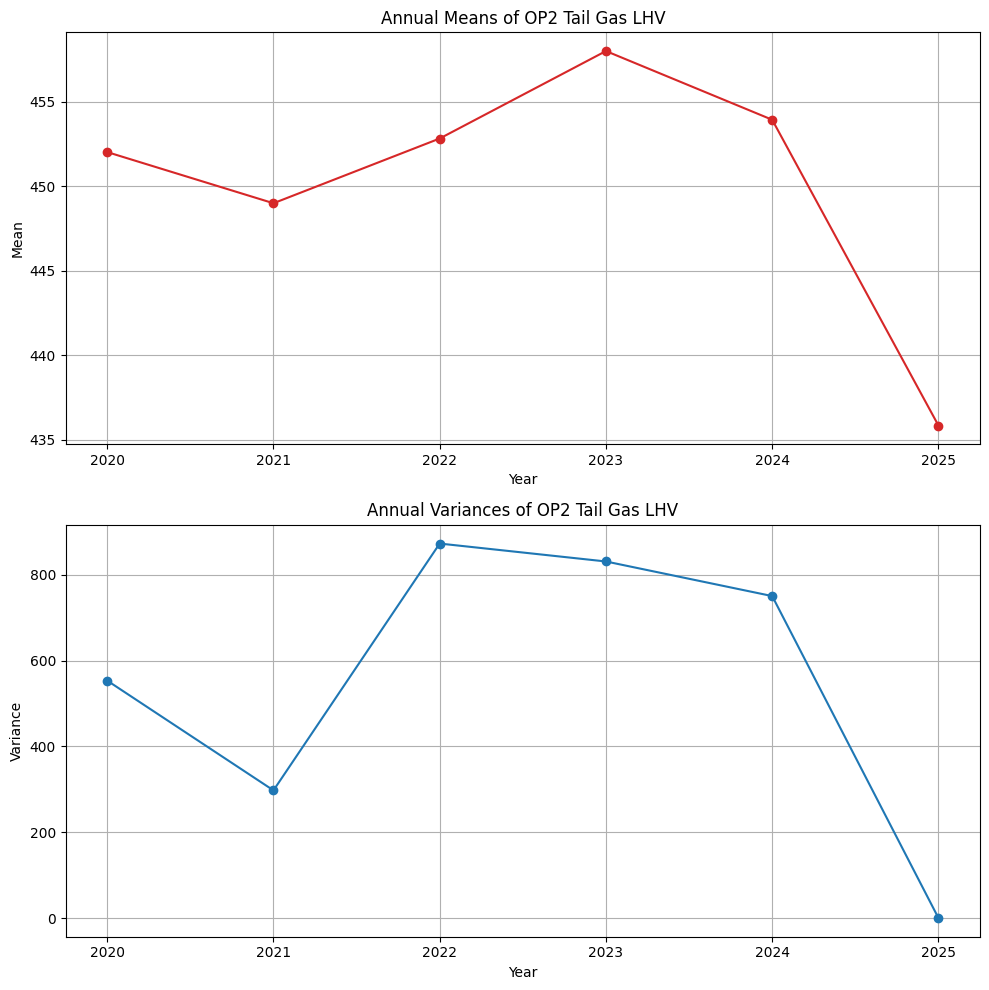

In [ ]:
plot_yearly_stats_separate(df, 'OP2 Tail Gas LHV')

### Augmented Dickey Fuller Test

In [ ]:
adf, pvalue, usedlag, nobs, critical_values, icbest = adfuller(df['OP2 Tail Gas LHV'])
print(f'ADF Statistic: {adf}')
print(f'p-value: {pvalue}')

ADF Statistic: -4.83867070591224
p-value: 4.5841384105631474e-05


## OP2 Tail Gas MW

### Min Max Value


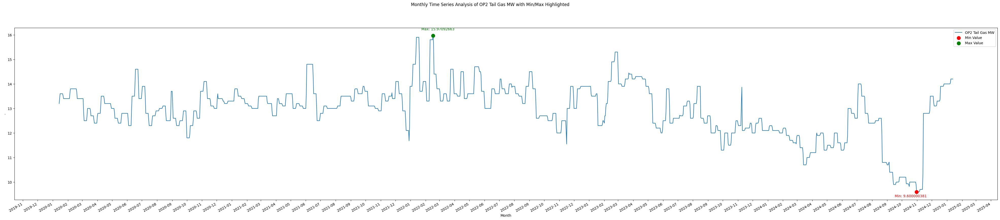

In [ ]:
plot_monthly_graph('OP2 Tail Gas MW','.')

### Histogram

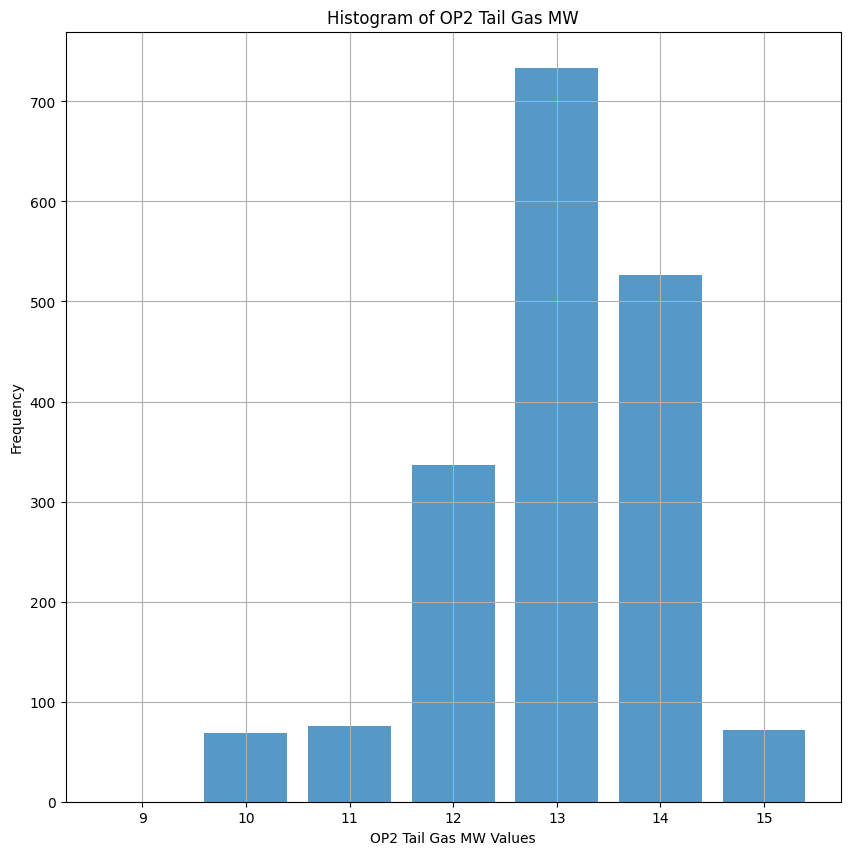

In [ ]:
#plot_dynamic_histogram(df,'OP2 Tail Gas MW',figsize=(100, 10),bin_width=2)
plot_individual_value_histogram(df,'OP2 Tail Gas MW',figsize=(10, 10))

### Mean and Variance Plot

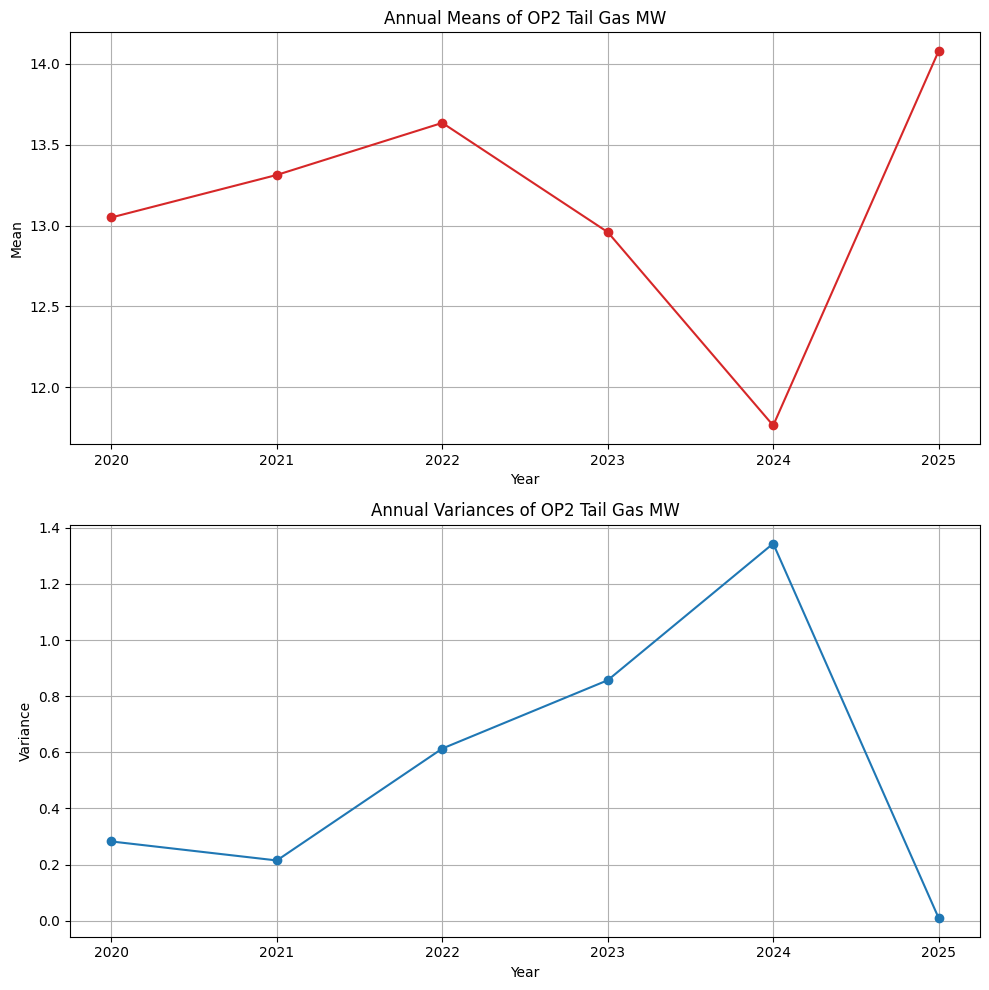

In [ ]:
plot_yearly_stats_separate(df, 'OP2 Tail Gas MW')

### Augmented Dickey Fuller Test


In [ ]:
adf, pvalue, usedlag, nobs, critical_values, icbest = adfuller(df['OP2 Tail Gas MW'])
print(f'ADF Statistic: {adf}')
print(f'p-value: {pvalue}')

ADF Statistic: -3.3071696423522785
p-value: 0.014561017317150355


## Flow - OP2 Tail Gas

### Min Max Value

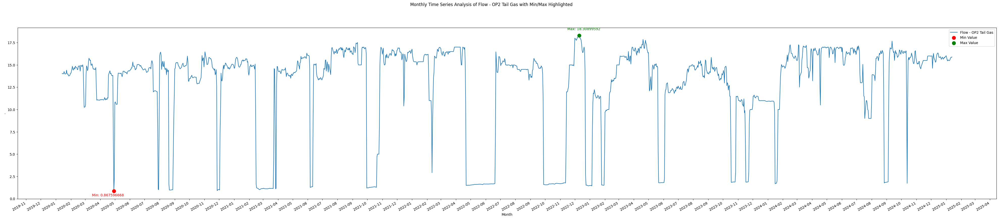

In [ ]:
plot_monthly_graph('Flow - OP2 Tail Gas','.')

### Histogram


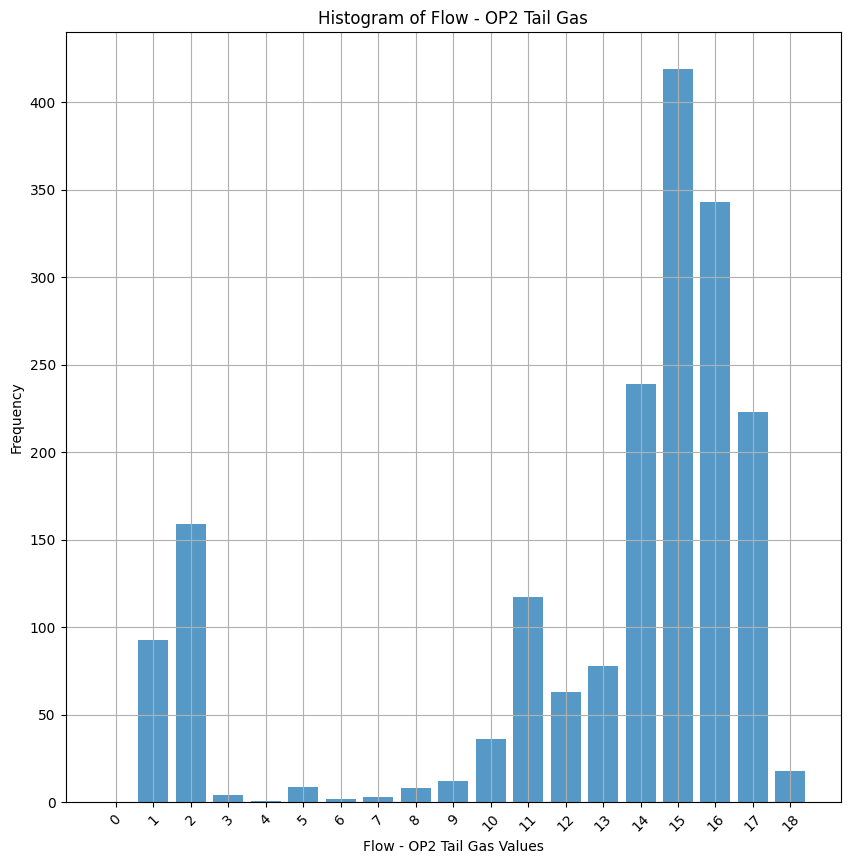

In [ ]:
plot_individual_value_histogram(df,'Flow - OP2 Tail Gas',figsize=(10, 10))

### Mean and Variance Plot

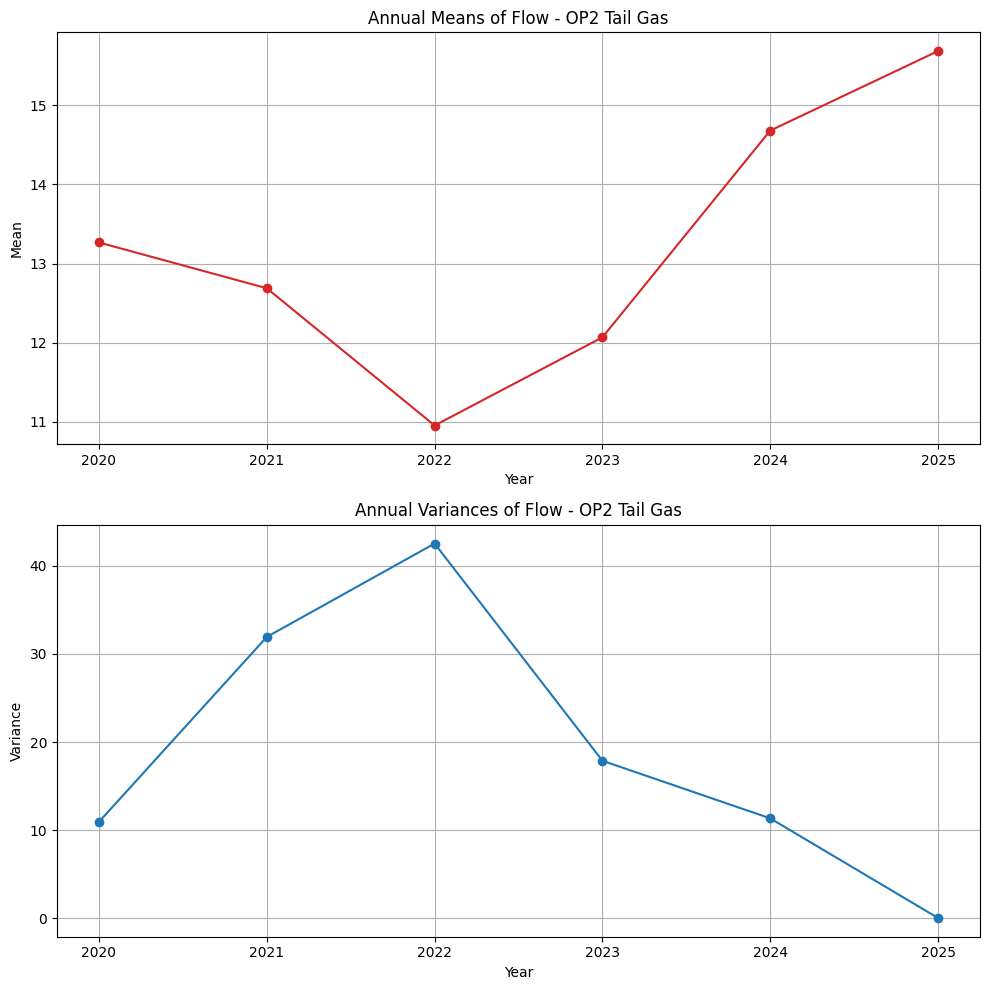

In [ ]:
plot_yearly_stats_separate(df, 'Flow - OP2 Tail Gas')

### Augmented Dickey Fuller Test

In [ ]:
adf, pvalue, usedlag, nobs, critical_values, icbest = adfuller(df['Flow - OP2 Tail Gas'])
print(f'ADF Statistic: {adf}')
print(f'p-value: {pvalue}')

ADF Statistic: -7.5109130180785515
p-value: 4.017934339465355e-11


## Firing Rate of HRVOC Fuels to BIF (EBT and OP2 Tail Gas), HHV

### Min Max Value


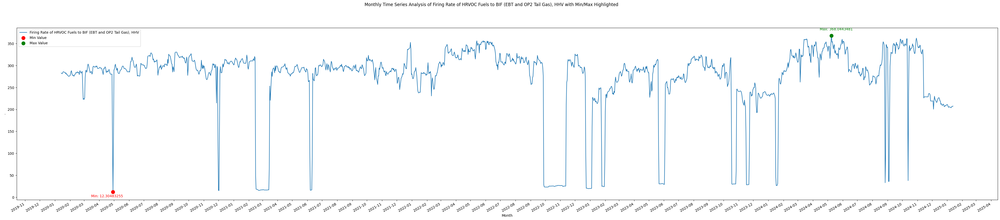

In [ ]:
plot_monthly_graph('Firing Rate of HRVOC Fuels to BIF (EBT and OP2 Tail Gas), HHV','.')

### Histogram


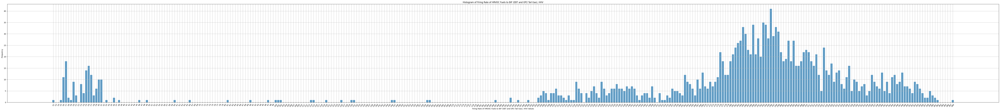

In [ ]:
plot_individual_value_histogram(df,'Firing Rate of HRVOC Fuels to BIF (EBT and OP2 Tail Gas), HHV',figsize=(100, 10))

### Mean and Variance Plot


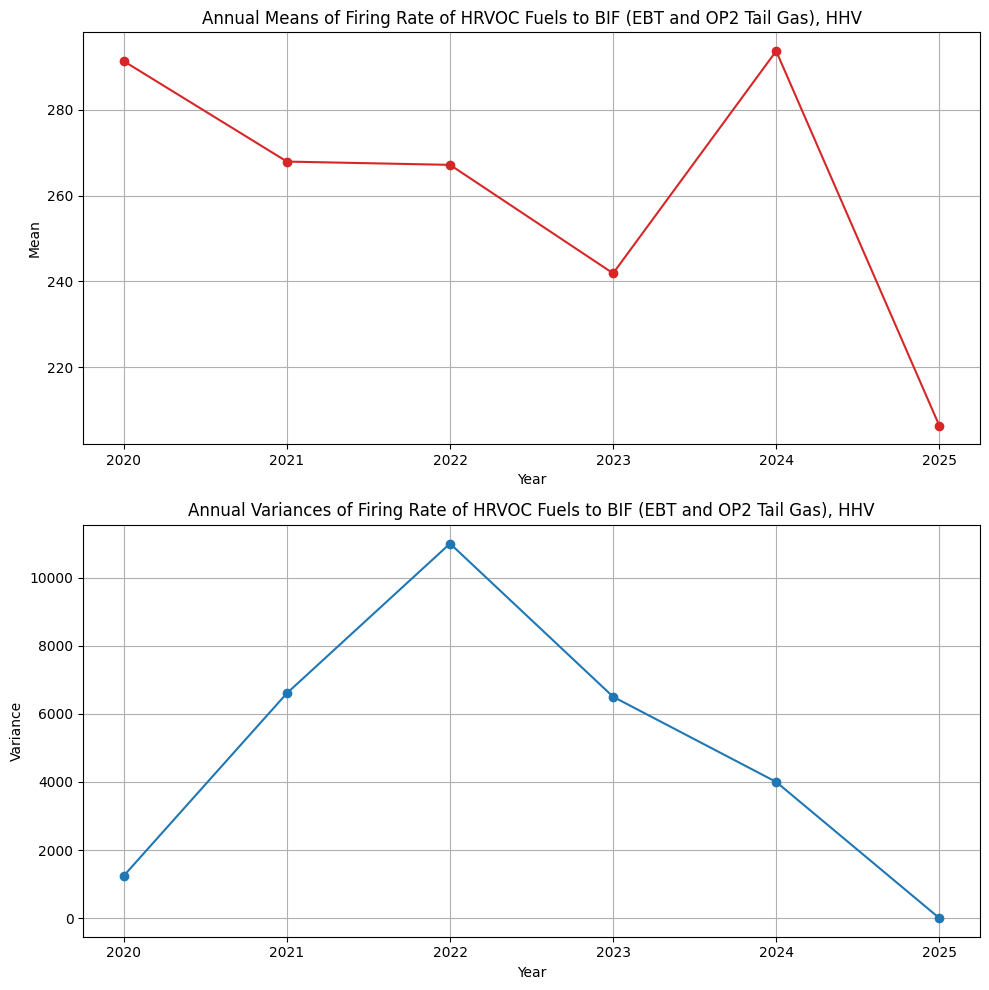

In [ ]:
plot_yearly_stats_separate(df, 'Firing Rate of HRVOC Fuels to BIF (EBT and OP2 Tail Gas), HHV')

### Augmented Dickey Fuller Test


In [ ]:
adf, pvalue, usedlag, nobs, critical_values, icbest = adfuller(df['Firing Rate of HRVOC Fuels to BIF (EBT and OP2 Tail Gas), HHV'])
print(f'ADF Statistic: {adf}')
print(f'p-value: {pvalue}')

ADF Statistic: -6.795408106845396
p-value: 2.3077572738733116e-09


##  Total Firing Rate of BIF (NG + EBT + OP2 Tail Gas + Phen HE), HHV


### Min Max Value

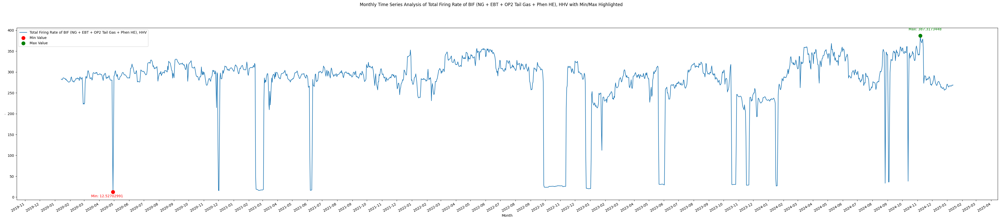

In [ ]:
plot_monthly_graph('Total Firing Rate of BIF (NG + EBT + OP2 Tail Gas + Phen HE), HHV','.')

### Histogram


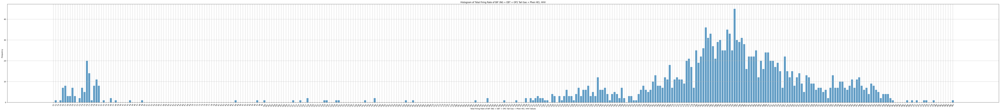

In [ ]:
plot_individual_value_histogram(df,'Total Firing Rate of BIF (NG + EBT + OP2 Tail Gas + Phen HE), HHV',figsize=(100, 10))

### Mean and Variance Plot


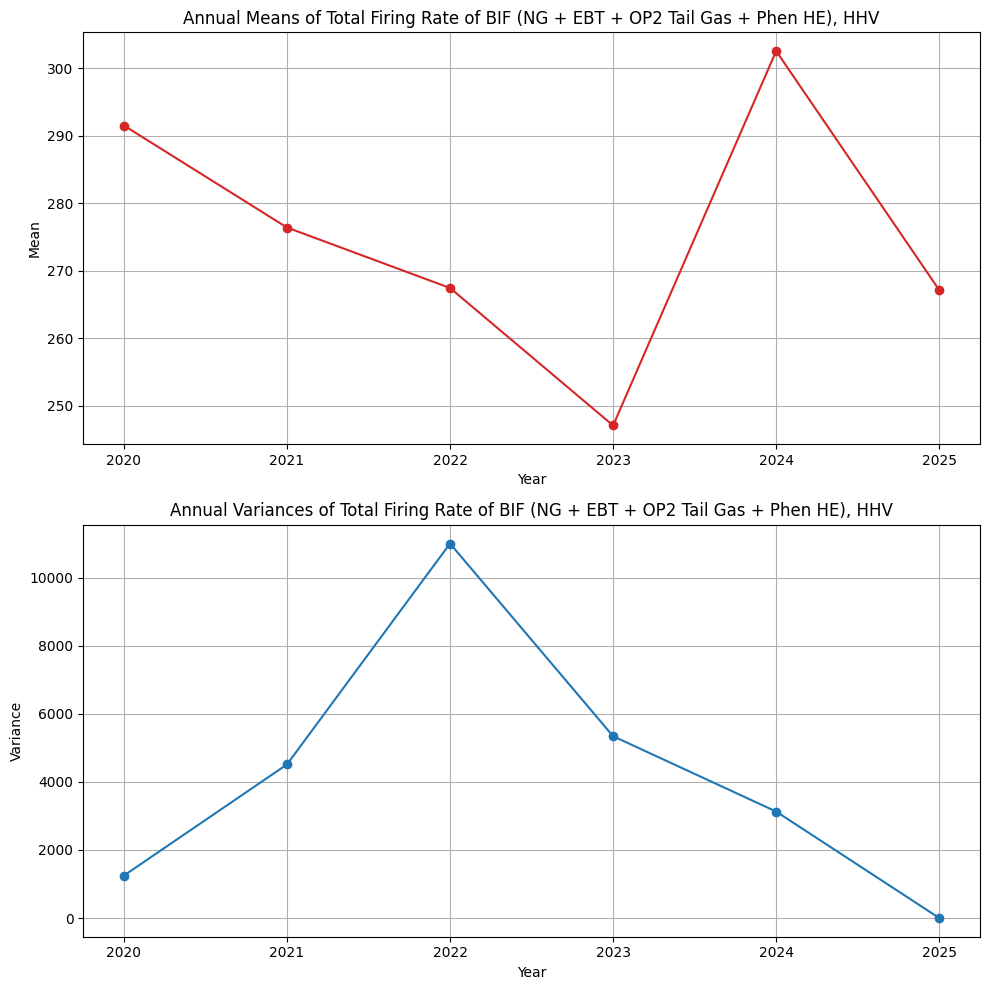

In [ ]:
plot_yearly_stats_separate(df, 'Total Firing Rate of BIF (NG + EBT + OP2 Tail Gas + Phen HE), HHV')

### Augmented Dickey Fuller Test


In [ ]:
adf, pvalue, usedlag, nobs, critical_values, icbest = adfuller(df['Total Firing Rate of BIF (NG + EBT + OP2 Tail Gas + Phen HE), HHV'])
print(f'ADF Statistic: {adf}')
print(f'p-value: {pvalue}')

ADF Statistic: -7.0965897251955905
p-value: 4.273586864807174e-10


## Heat - TG

### Min Max Value


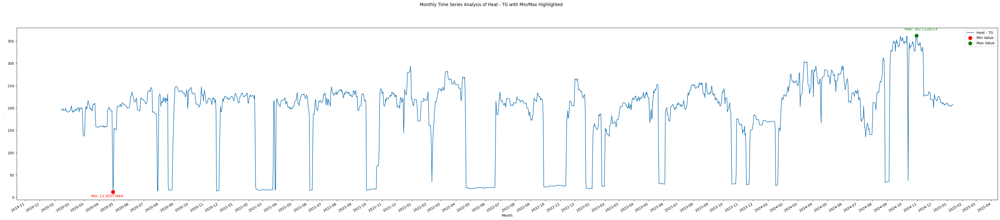

In [ ]:
plot_monthly_graph('Heat - TG','.')

### Histogram

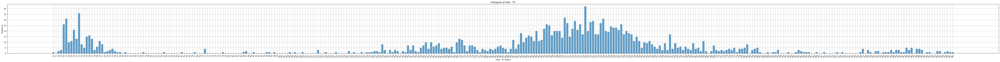

In [ ]:
plot_individual_value_histogram(df,'Heat - TG',figsize=(100, 5))

### Mean and Variance Plot


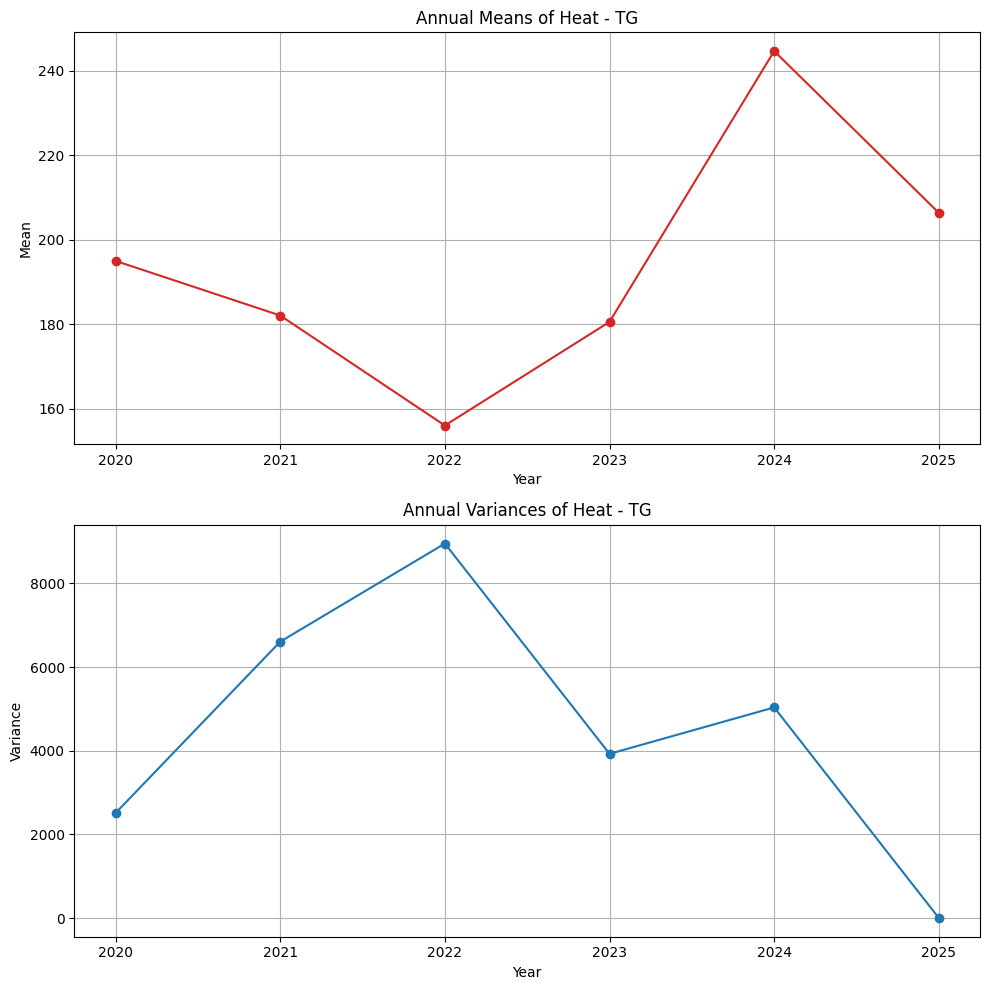

In [ ]:
plot_yearly_stats_separate(df, 'Heat - TG')

### Augmented Dickey Fuller Test


In [ ]:
adf, pvalue, usedlag, nobs, critical_values, icbest = adfuller(df['Heat - TG'])
print(f'ADF Statistic: {adf}')
print(f'p-value: {pvalue}')


ADF Statistic: -6.977717025623408
p-value: 8.345135428177939e-10


## HRVOC Steam Production

### Min Max Value


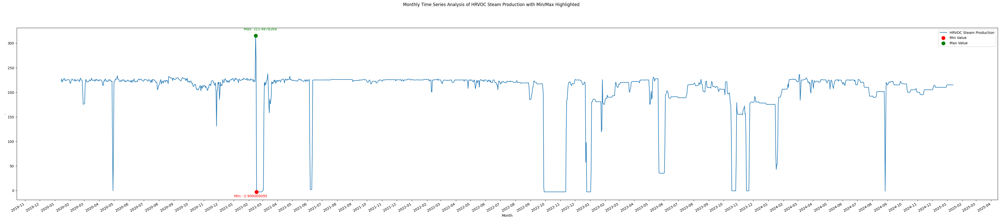

In [ ]:
plot_monthly_graph('HRVOC Steam Production','.')

### Histogram


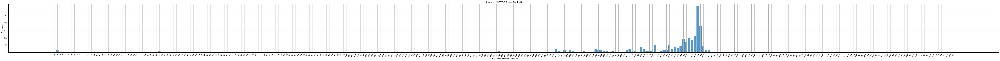

In [ ]:
plot_individual_value_histogram(df,'HRVOC Steam Production',figsize=(100, 5))

### Mean and Variance Plot


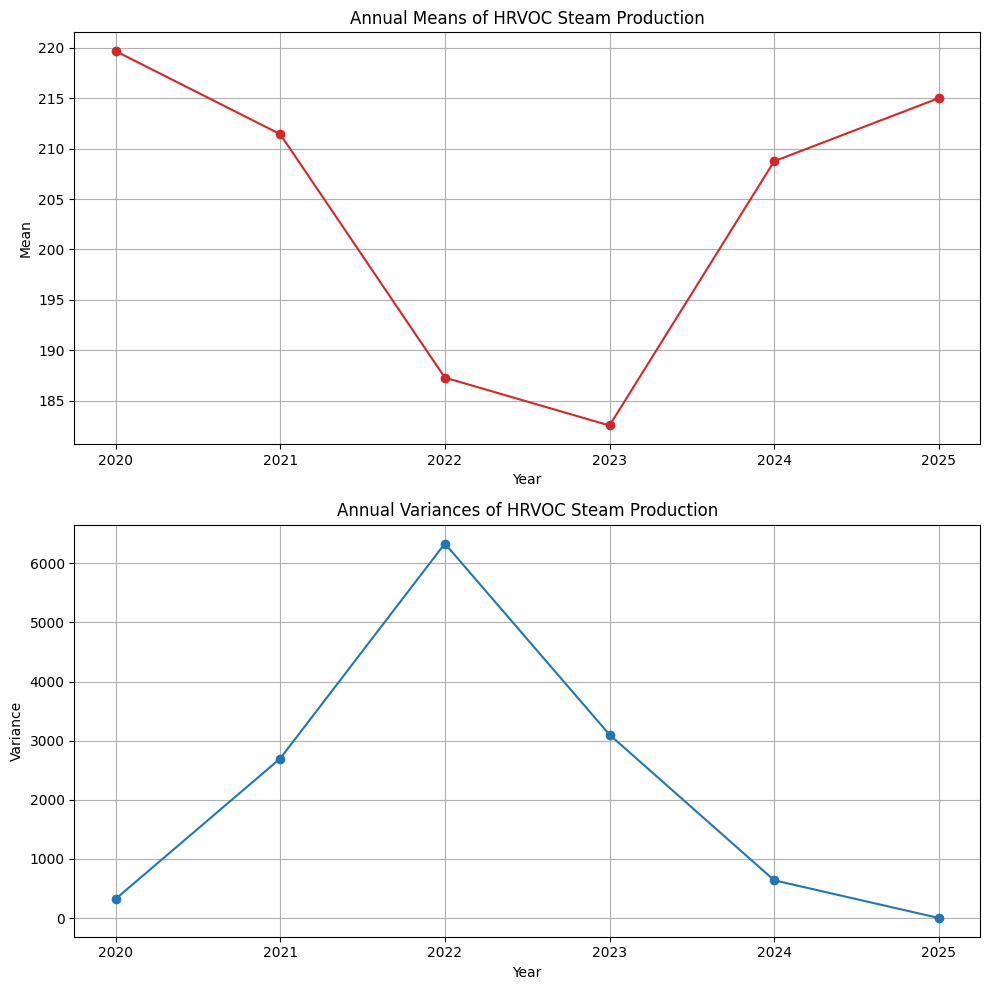

In [ ]:
plot_yearly_stats_separate(df, 'HRVOC Steam Production')

### Augmented Dickey Fuller Test

In [ ]:
adf, pvalue, usedlag, nobs, critical_values, icbest = adfuller(df['HRVOC Steam Production'])
print(f'ADF Statistic: {adf}')
print(f'p-value: {pvalue}')

ADF Statistic: -8.06744758068276
p-value: 1.582263140438171e-12


## Flow - RFG

### Min Max Value


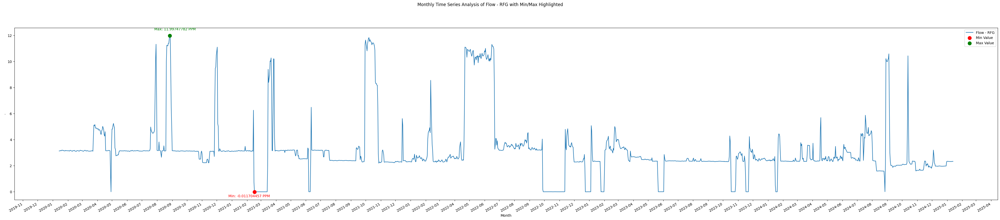

In [ ]:
plot_monthly_graph('Flow - RFG','.')

### Histogram


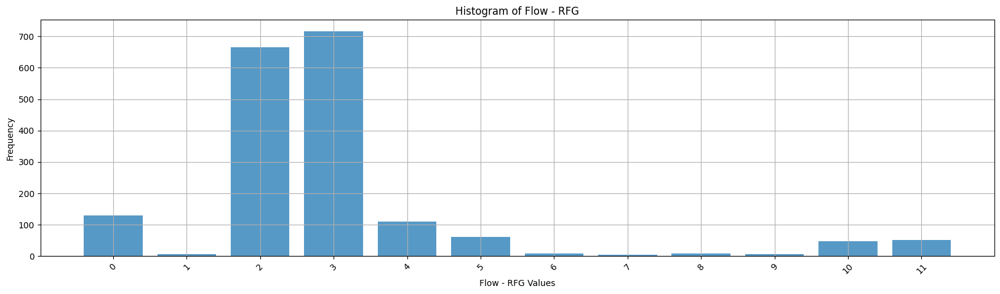

In [ ]:
plot_individual_value_histogram(df,'Flow - RFG',figsize=(20, 5))

### Mean and Variance Plot


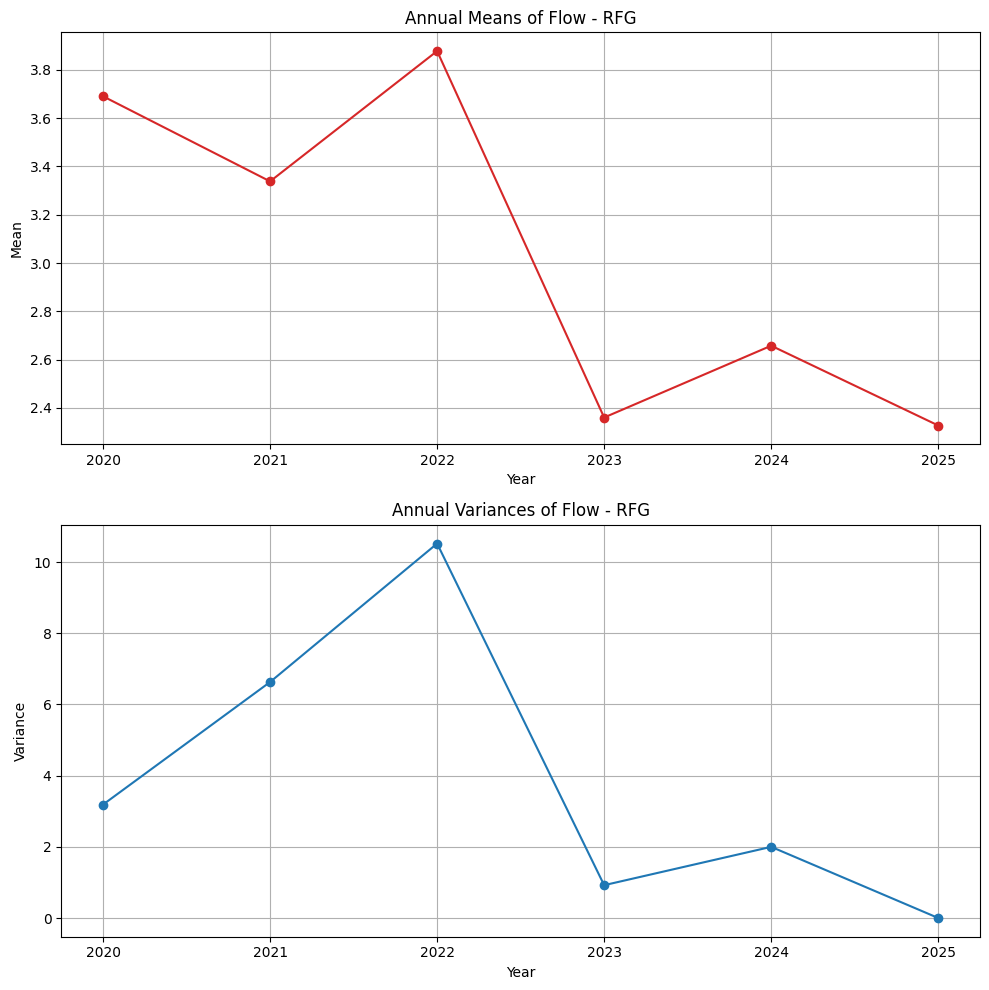

In [ ]:
plot_yearly_stats_separate(df, 'Flow - RFG')

### Augmented Dickey Fuller Test

In [ ]:
adf, pvalue, usedlag, nobs, critical_values, icbest = adfuller(df['Flow - RFG'])
print(f'ADF Statistic: {adf}')
print(f'p-value: {pvalue}')

ADF Statistic: -6.517017530861137
p-value: 1.0650825146647442e-08
